# **Sentimental Analysis with NLP**

In [ ]:
# import libraries
import pandas as pd
import numpy as np

#hashtag removal
import re

# libraries for data preprocessing
import nltk
# download modules available with NLTK
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('stopwords')

#Visualization
import plotly.express as px
import plotly.graph_objects as go
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from PIL import Image
import io
import base64

from nltk.tokenize import TweetTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
import spacy

# libraries for data split and feature extraction
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

# library for evaluation
from sklearn import metrics

# libraries for ML algorithms
from sklearn import svm
from sklearn import tree
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB
from sklearn.ensemble import RandomForestClassifier

# libraries for data plotting
import seaborn as sns
import matplotlib.pyplot as plt

RANDOM_SEED = 100

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
/usr/local/lib/python3.8/dist-packages/torch/cuda/__init__.py:497: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


## Data Importation

In [ ]:
#Data Importation
df = pd.read_csv('train.csv')

In [ ]:
df.head()

,id,text,sentiment
0,549e992a42,Sooo SAD I will miss you here in San Diego!!!,negative
1,088c60f138,my boss is bullying me...,negative
2,9642c003ef,what interview! leave me alone,negative
3,358bd9e861,"Sons of ****, why couldn`t they put them on t...",negative
4,6e0c6d75b1,2am feedings for the baby are fun when he is a...,positive


In [ ]:
#Removing hashtags and mentions

clean_tweet = df['text'].apply(lambda tweet: re.sub("@[A-Za-z0-9_]+","", tweet))
clean_tweet = clean_tweet.apply(lambda tweet: re.sub("#[A-Za-z0-9_]+","", tweet))


In [ ]:
clean_tweet.head()

0        Sooo SAD I will miss you here in San Diego!!!
1                            my boss is bullying me...
2                       what interview! leave me alone
3     Sons of ****, why couldn`t they put them on t...
4    2am feedings for the baby are fun when he is a...
Name: text, dtype: object

In [ ]:
df['Clean_Tweet'] = clean_tweet
df.head()

,id,text,sentiment,Clean_Tweet
0,549e992a42,Sooo SAD I will miss you here in San Diego!!!,negative,Sooo SAD I will miss you here in San Diego!!!
1,088c60f138,my boss is bullying me...,negative,my boss is bullying me...
2,9642c003ef,what interview! leave me alone,negative,what interview! leave me alone
3,358bd9e861,"Sons of ****, why couldn`t they put them on t...",negative,"Sons of ****, why couldn`t they put them on t..."
4,6e0c6d75b1,2am feedings for the baby are fun when he is a...,positive,2am feedings for the baby are fun when he is a...


## Cleaning

In [ ]:
#drop the id column
df.drop(columns= 'id', inplace=True)

In [ ]:
#Check for null values
df.isna().sum()


text           0
sentiment      0
Clean_Tweet    0
dtype: int64

In [ ]:
df.head()

,text,sentiment,Clean_Tweet
0,Sooo SAD I will miss you here in San Diego!!!,negative,Sooo SAD I will miss you here in San Diego!!!
1,my boss is bullying me...,negative,my boss is bullying me...
2,what interview! leave me alone,negative,what interview! leave me alone
3,"Sons of ****, why couldn`t they put them on t...",negative,"Sons of ****, why couldn`t they put them on t..."
4,2am feedings for the baby are fun when he is a...,positive,2am feedings for the baby are fun when he is a...


## **Visualizations**

**Word Frequency Count**

In [ ]:
cv = CountVectorizer(stop_words='english')
words = cv.fit_transform(df.text)

sum_words = words.sum(axis=0)
words_freq = [(word, sum_words[0, i]) for word, i in cv.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)

frequency = pd.DataFrame(words_freq, columns=['word', 'freq'])
top_words = frequency.head(40)

# Choose a color palette from Plotly Express
colors = px.colors.sequential.Purples[0:16][::-1]

fig = go.Figure()
fig.add_trace(go.Bar(x=top_words['word'], y=top_words['freq'], marker_color=colors))
fig.update_layout(title='Most Frequently Occurring Words - Top 40', xaxis_title='Words', yaxis_title='Frequency')

fig.show()



### **Word Vocabulary Visualization**

In [ ]:
wordcloud = WordCloud(background_color='white', width=1000, height=1000, colormap='Dark2').generate_from_frequencies(dict(words_freq))

fig = go.Figure(go.Image(z=wordcloud.to_array()))
fig.update_layout(title='WordCloud - Vocabulary from Reviews', title_font_size=22)

fig.show()



## **Negative Words Visualization**

In [ ]:
negative_words =' '.join([text for text in df['text'][df['sentiment'] == 'negative']])

wordcloud = WordCloud(width=800, height=500, random_state=0, max_font_size=110, colormap='Reds_r').generate(negative_words)

fig = go.Figure(go.Image(z=wordcloud.to_array()))
fig.update_layout(plot_bgcolor= 'black', paper_bgcolor= 'black', title='The Negative Words', title_font_size=22, xaxis=dict(showticklabels=False), yaxis=dict(showticklabels=False))

fig.show()



### **Postive Words Visualization**


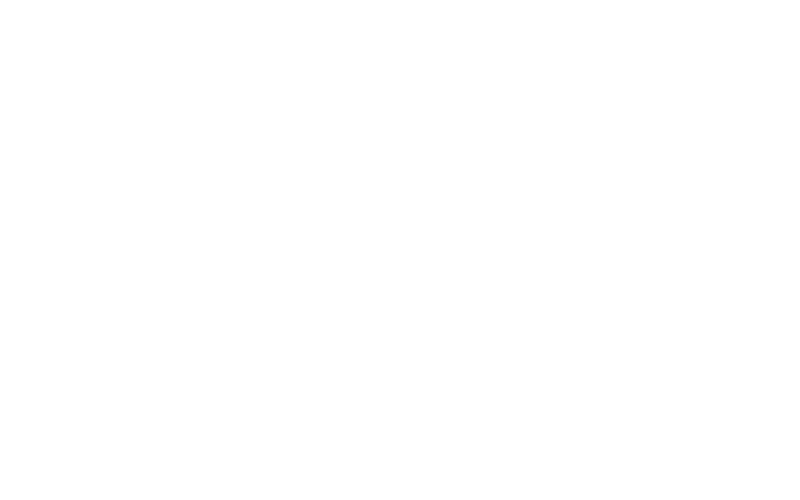

In [ ]:


normal_words =' '.join([text for text in df['text'][df['sentiment'] == 'positive']])

wordcloud = WordCloud(background_color='#B2DFDB', width=800, height=500, random_state=0, max_font_size=110, colormap='Dark2').generate(normal_words)

# Create a mask that defines the shape of the background color
mask = np.zeros((wordcloud.height, wordcloud.width), dtype=np.uint8)
mask[wordcloud.to_array().sum(axis=2) > 0] = 255

# Convert the mask to a PIL Image object
mask_pil = Image.fromarray(mask)

# Save the mask as a data URI image string
mask_buffer = io.BytesIO()
mask_pil.save(mask_buffer, format='png')
mask_data = mask_buffer.getvalue()
mask_data_uri = "data:image/png;base64," + str(base64.b64encode(mask_data))[2:-1]

fig = go.Figure(go.Image(z=wordcloud.to_array()))
fig.update_layout(title='The Positive Words', title_font_size=22, xaxis=dict(showticklabels=False), yaxis=dict(showticklabels=False), paper_bgcolor='#B2DFDB')

fig.add_layout_image(
    go.layout.Image(
        source=mask_data_uri,
        xref="x",
        yref="y",
        x=0,
        y=0,
        sizex=1,
        sizey=1,
        sizing="stretch",
        opacity=0.5,
        layer="below")
)

fig.show()



### **Countplot of negative and positive Sentiments**

In [ ]:

# Group comments by sentiment
grouped_data = df.groupby("sentiment")

# Define a custom color palette for positive and negative sentiment
positive_color = "pink"
negative_color = "purple"

# Create a countplot using Plotly with custom colors based on sentiment
fig = px.histogram(grouped_data, x=df["sentiment"], color=df["sentiment"],
                   color_discrete_map={"positive": positive_color, "negative": negative_color})

fig.update_layout(plot_bgcolor="white", paper_bgcolor='white')

# Show the figure
fig.show()




## **Data Preprocessing**

### **Tokenization**

In [ ]:
tknzr = TweetTokenizer(reduce_len=True)

# iterate through each row in 'Text' columm and convert text to tokens
list_tokenised_text = [tknzr.tokenize(text) for text in df['text']]

list_tokenised_sentences = [' '.join(tokens) for tokens in list_tokenised_text]

# add new column to data frame
df['Tokenised_Text'] = list_tokenised_sentences
df.head()

,text,sentiment,Clean_Tweet,Tokenised_Text
0,Sooo SAD I will miss you here in San Diego!!!,negative,Sooo SAD I will miss you here in San Diego!!!,Sooo SAD I will miss you here in San Diego ! ! !
1,my boss is bullying me...,negative,my boss is bullying me...,my boss is bullying me ...
2,what interview! leave me alone,negative,what interview! leave me alone,what interview ! leave me alone
3,"Sons of ****, why couldn`t they put them on t...",negative,"Sons of ****, why couldn`t they put them on t...","Sons of * * * , why couldn ` t they put them o..."
4,2am feedings for the baby are fun when he is a...,positive,2am feedings for the baby are fun when he is a...,2am feedings for the baby are fun when he is a...


## Lemmatization

In [ ]:
wnl = WordNetLemmatizer()

list_lemmatised_sentences = []

# iterate through each list of tokens and lemmatise the tokens
for tokens in list_tokenised_text:
  lemma_words = [wnl.lemmatize(word) for word in tokens]
  lemma_sentence = ' '.join(lemma_words)
  list_lemmatised_sentences.append(lemma_sentence)

# add new column to data frame
df['Lemmatised_Text'] = list_lemmatised_sentences

df.head()

,text,sentiment,Clean_Tweet,Tokenised_Text,Lemmatised_Text
0,Sooo SAD I will miss you here in San Diego!!!,negative,Sooo SAD I will miss you here in San Diego!!!,Sooo SAD I will miss you here in San Diego ! ! !,Sooo SAD I will miss you here in San Diego ! ! !
1,my boss is bullying me...,negative,my boss is bullying me...,my boss is bullying me ...,my bos is bullying me ...
2,what interview! leave me alone,negative,what interview! leave me alone,what interview ! leave me alone,what interview ! leave me alone
3,"Sons of ****, why couldn`t they put them on t...",negative,"Sons of ****, why couldn`t they put them on t...","Sons of * * * , why couldn ` t they put them o...","Sons of * * * , why couldn ` t they put them o..."
4,2am feedings for the baby are fun when he is a...,positive,2am feedings for the baby are fun when he is a...,2am feedings for the baby are fun when he is a...,2am feeding for the baby are fun when he is al...


## Stop word removal

### In our sentiment analysis, using the stop word dictionary would likely impede the sentimental search process as sentimental words usually have stop words that further strenghten the sentiments of the text.

### A customized stop word list, containing fewer words is created instead

In [ ]:
#custom stop words list
custom_stop_words = ['a', 'the', 'and', 'ma', 'sir', 'as', 'if']

## **Splitting Data**

In [ ]:
# use raw text
X_train_text, X_val_text, y_train, y_val = train_test_split(df['text'], df['sentiment'], test_size=0.3, random_state=RANDOM_SEED)
print(f'training data set size: {len(X_train_text)}')
print(f'validation data set size: {len(X_val_text)}')

# use tokenised text
X_train_tokenised_text, X_val_tokenised_text, y_train, y_val = train_test_split(df['Tokenised_Text'], df['sentiment'], test_size=0.3, random_state=RANDOM_SEED)
print(f'training data set size: {len(X_train_tokenised_text)}')
print(f'validation data set size: {len(X_val_tokenised_text)}')

# use lemmatised text
X_train_lemmatised_text, X_val_lemmatised_text, y_train, y_val = train_test_split(df['Lemmatised_Text'], df['sentiment'], test_size=0.3, random_state=RANDOM_SEED)
print(f'training data set size: {len(X_train_lemmatised_text)}')
print(f'validation data set size: {len(X_val_lemmatised_text)}')

# use clean text
X_train_clean_text, X_val_clean_text, y_train, y_val = train_test_split(df['Clean_Tweet'], df['sentiment'], test_size=0.3, random_state=RANDOM_SEED)
print(f'training data set size: {len(X_train_clean_text)}')
print(f'validation data set size: {len(X_val_clean_text)}')

# define class_names to using with plot_confusion_matrix
class_list = ['positive', 'negative']

training data set size: 11454
validation data set size: 4909
training data set size: 11454
validation data set size: 4909
training data set size: 11454
validation data set size: 4909
training data set size: 11454
validation data set size: 4909


In [ ]:
# method to plot confusion matrix
def plot_confusion_matrix(matrix, class_names):
    plt.clf()
    plt.imshow(matrix, interpolation='nearest', cmap=plt.cm.Set2_r)
    plt.title('Confusion Matrix')
    plt.ylabel('Actual')
    plt.xlabel('Predicted')
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names)
    plt.yticks(tick_marks, class_names)
    s = [['TP','FP'], ['FN', 'TN']]

    for i in range(2):
        for j in range(2):
            plt.text(j,i, str(s[i][j])+" = "+str(matrix[i][j]))
    plt.show()

# method to calculate evaluation results
def evaluate(actuals, predictions, class_names):
  accuracy = metrics.accuracy_score(actuals, predictions)
  confusion_matrix = metrics.confusion_matrix(actuals, predictions, labels=class_names)
  return accuracy, confusion_matrix

## Model Definitions

### SVM Classifier

In [ ]:
# method to train and predict using SVM classifier
def get_svm_predictions(X_train, X_val, y_train, y_val, class_names):
  # build model
  clf = svm.SVC(kernel='linear', random_state=RANDOM_SEED, )
  clf.fit(X_train, y_train)

  # Make predictions on test data
  y_pred = clf.predict(X_val)

  # evalution
  accuracy, confusion_matrix = evaluate(y_val, y_pred, class_names)
  print(f'Accuracy: {accuracy}')
  plot_confusion_matrix(confusion_matrix, class_names)

  return clf

### Decision Tree Classifier

In [ ]:
# method to train and predict using Decision Tree
def get_dt_predictions(X_train, X_val, y_train, y_val, class_list):
  # build model
  clf = tree.DecisionTreeClassifier(random_state=RANDOM_SEED)
  clf.fit(X_train, y_train)

  # Make predictions on test data
  y_pred = clf.predict(X_val)

  # evalution
  accuracy, confusion_matrix = evaluate(y_val, y_pred, class_list)
  print(f'Accuracy: {accuracy}')
  plot_confusion_matrix(confusion_matrix, class_list)

  return clf

### Random Forest Classifier

In [ ]:
# method to train and predict using Random Forest
def get_rf_predictions(X_train, X_val, y_train, y_val, class_list):
  # build model
  clf = RandomForestClassifier(n_estimators=137, random_state=100)
  clf.fit(X_train, y_train)

  # Make predictions on test data
  y_pred = clf.predict(X_val)

  # evalution
  accuracy, confusion_matrix = evaluate(y_val, y_pred, class_list)
  print(f'Accuracy: {accuracy}')
  plot_confusion_matrix(confusion_matrix, class_list)

  return clf

### NaiveBayes Classifier

In [ ]:
def get_NB_predictions(X_train, X_val, y_train, y_val, class_list):
  # Convert sparse matrices to dense numpy arrays
  X_train = X_train.toarray()
  X_val = X_val.toarray()

  # Convert Pandas Series to numpy arrays
  y_train = y_train.values
  y_val = y_val.values

  # build model
  clf = GaussianNB()
  clf.fit(X_train, y_train)

  # Make predictions on test data
  y_pred = clf.predict(X_val)

  # evalution
  accuracy, confusion_matrix = evaluate(y_val, y_pred, class_list)
  print(f'Accuracy: {accuracy}')
  plot_confusion_matrix(confusion_matrix, class_list)

  return clf


## **Scenarios**

### Model 1
### Vectorization Technique: CountVector: lowercase=True
### ngram_range = (1,1)
### Train data: Raw Text
### Training Model: SVM

Accuracy: 0.8602566714198411


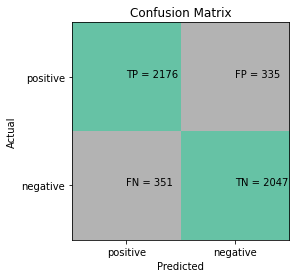

In [ ]:
model = 'Model 1'
Vectorization_Technique = 'CountVector'
lowercase= 'True'
ngram_range = (1,1)
Train_data = 'Raw Text'
Training_Model = 'SVM'
stopwords = 'No'

vectorizer = CountVectorizer()  # default: lowercase=True, ngram_range=(1,1)
vectorizer.fit(X_train_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_text)
X_val = vectorizer.transform(X_val_text)

m1 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 2
### Vectorization Technique: TfidfVector: lowercase=True
### ngram_range = (1,1)
### Train data: Raw Text
### Training Model: SVM

Accuracy: 0.8690160928906091


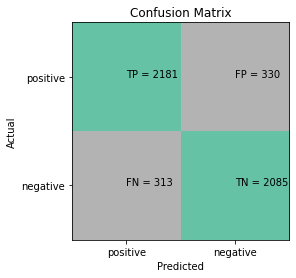

In [ ]:
model = 'Model 2'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,1)
Train_data = 'Raw Text'
Training_Model = 'SVM'
stopwords = 'No'

vectorizer = TfidfVectorizer(ngram_range=(1,1))
vectorizer.fit(X_train_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_text)
X_val = vectorizer.transform(X_val_text)

m2 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 3
### Vectorization Technique: TfidfVector: lowercase=False
### ngram_range = (1,1)
### Train data: Raw Text
### Training Model: SVM

Accuracy: 0.8633122835608067


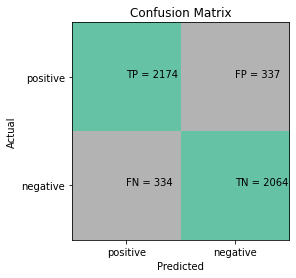

In [ ]:
model = 'Model 3'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'False'
ngram_range = (1,1)
Train_data = 'Raw Text'
Training_Model = 'SVM'
stopwords = 'No'

vectorizer = TfidfVectorizer(lowercase=False)
vectorizer.fit(X_train_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_text)
X_val = vectorizer.transform(X_val_text)

m3 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 4
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,1)
### Train data: Tokenised text
### Training Model: SVM

Accuracy: 0.8716642900794459


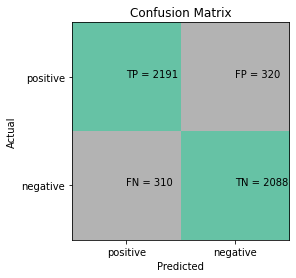

In [ ]:
model = 'Model 4'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,1)
Train_data = 'Tokenised Text'
Training_Model = 'SVM'
stopwords = 'No'

vectorizer = TfidfVectorizer()
vectorizer.fit(X_train_tokenised_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_tokenised_text)
X_val = vectorizer.transform(X_val_tokenised_text)

m4 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 5
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,1)
### Train data: Lemmatized text
### Training Model: SVM

Accuracy: 0.870034630270931


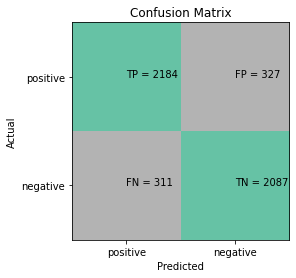

In [ ]:
model = 'Model 5'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,1)
Train_data = 'Lemmatized Text'
Training_Model = 'SVM'
stopwords = 'No'

vectorizer = TfidfVectorizer()
vectorizer.fit(X_train_lemmatised_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_lemmatised_text)
X_val = vectorizer.transform(X_val_lemmatised_text)

m5 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 6
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,2)
### Train data: Tokenized text
### Training Model: SVM

Accuracy: 0.8753310246486046


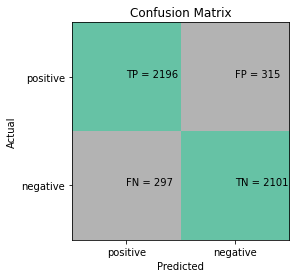

In [ ]:
model = 'Model 6'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'Tokenised Text'
Training_Model = 'SVM'
stopwords = 'No'

vectorizer = TfidfVectorizer(ngram_range=(1,2))
vectorizer.fit(X_train_lemmatised_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_tokenised_text)
X_val = vectorizer.transform(X_val_tokenised_text)

m6 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 7
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,2)
### Train data: Tokenized text
### Training Model: SVM
### Stop words = Custom stopwords

Accuracy: 0.8796088816459564


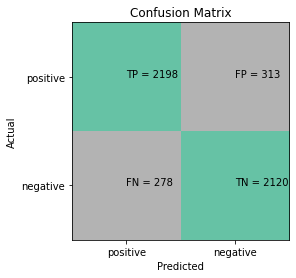

In [ ]:
model = 'Model 7'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'Tokenised Text'
Training_Model = 'SVM'
stopwords = 'custom_stop_words'

vectorizer = TfidfVectorizer(ngram_range=(1,2), stop_words=custom_stop_words)
vectorizer.fit(X_train_lemmatised_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_tokenised_text)
X_val = vectorizer.transform(X_val_tokenised_text)

m7 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### model = 'Model 8'
### Vectorization_Technique = 'TfidfVectorizer'
### lowercase= 'True'
### ngram_range = (1,2)
### Training_Model = 'DecisionTree'
### stopwords = 'custom_stop_words'

Accuracy: 0.8019963332654308


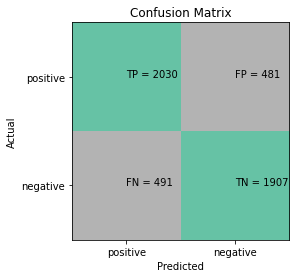

In [ ]:
model = 'Model 8'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'Tokenised Text'
Training_Model = 'DecisionTree'
stopwords = 'custom_stop_words'


m8 = get_dt_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 9
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,2)
### Train data: Tokenized text
### Training Model: Random Forest Classifier
### stopwords = 'custom_stop_words'

Accuracy: 0.8478305153799145


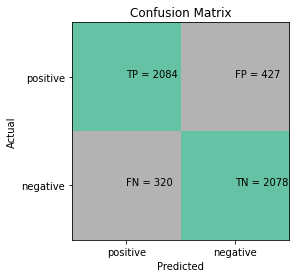

In [ ]:
model = 'Model 9'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'Tokenised Text'
Training_Model = 'DecisionTree'
stopwords = 'custom_stop_words'

m9 = get_rf_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 10
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,2)
### Train data: Tokenized text
### Training Model:  Naive Bayes Classifier
### Stop words

Accuracy: 0.7182725606029742


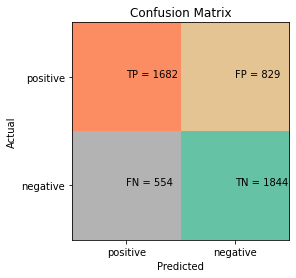

In [ ]:
model = 'Model 10'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'Tokenised Text'
Training_Model = 'NaiveBayes'
stopwords = 'custom_stop_words'

M10 = get_NB_predictions(X_train, X_val, y_train, y_val, class_list)

# **Model Optimization**

## **Changing the kernel of the svm model**

In [ ]:
# SVM kernel == rbf

def get_svm_predictions(X_train, X_val, y_train, y_val, class_names):
  # build model
  clf = svm.SVC(kernel='rbf', random_state=RANDOM_SEED, )
  clf.fit(X_train, y_train)

  # Make predictions on test data
  y_pred = clf.predict(X_val)

  # evalution
  accuracy, confusion_matrix = evaluate(y_val, y_pred, class_names)
  print(f'Accuracy: {accuracy}')
  plot_confusion_matrix(confusion_matrix, class_names)

  return clf

### model = 'Model 11'
### Vectorization_Technique = 'TfidfVectorizer'
### lowercase= 'True'
### ngram_range = (1,2)
### Training_Model = 'SVM --rbf'
### stopwords = 'custom_stop_words'

Accuracy: 0.8686086779384803


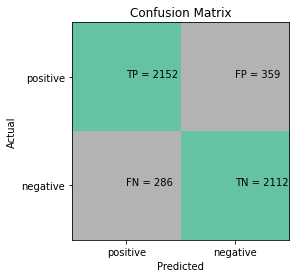

In [ ]:
model = 'Model 11'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'Tokenised Text'
Training_Model = 'SVM'
stopwords = 'custom_stop_words'

vectorizer = TfidfVectorizer(ngram_range=(1,2), stop_words=custom_stop_words)
vectorizer.fit(X_train_lemmatised_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_tokenised_text)
X_val = vectorizer.transform(X_val_tokenised_text)

m11 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 12
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,2)
### Train data: Tokenized text
### Training Model: SVM -- poly
### Stop words

In [ ]:
# SVM kernel == poly

def get_svm_predictions(X_train, X_val, y_train, y_val, class_names):
  # build model
  clf = svm.SVC(kernel='poly', random_state=RANDOM_SEED, )
  clf.fit(X_train, y_train)

  # Make predictions on test data
  y_pred = clf.predict(X_val)

  # evalution
  accuracy, confusion_matrix = evaluate(y_val, y_pred, class_names)
  print(f'Accuracy: {accuracy}')
  plot_confusion_matrix(confusion_matrix, class_names)

  return clf

Accuracy: 0.7233652475045834


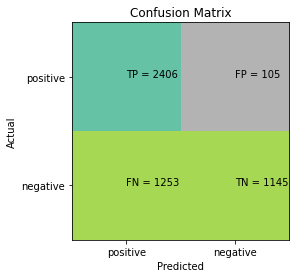

In [ ]:
model = 'Model 12'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'Tokenised Text'
Training_Model = 'SVM --poly'
stopwords = 'custom_stop_words'

vectorizer = TfidfVectorizer(ngram_range=(1,2), stop_words=custom_stop_words)
vectorizer.fit(X_train_lemmatised_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_tokenised_text)
X_val = vectorizer.transform(X_val_tokenised_text)

m12 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

## **Increasing the n-grams to (1,3)**

### Model 13
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,3)
### Train data: Tokenized text
### Training Model: SVM
### Stop words

Accuracy: 0.8755347321246689


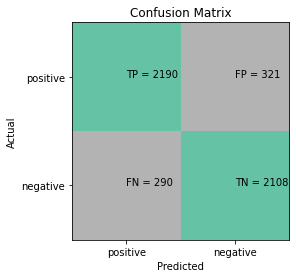

In [ ]:
model = 'Model 13'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,3)
Train_data = 'Tokenised Text'
Training_Model = 'SVM'
stopwords = 'custom_stop_words'

vectorizer = TfidfVectorizer(ngram_range=(1,3), stop_words=custom_stop_words)
vectorizer.fit(X_train_lemmatised_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_tokenised_text)
X_val = vectorizer.transform(X_val_tokenised_text)

m13 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

## **Implementing spaCy Lemmatizer**

In [ ]:
df1 = df[['text', 'sentiment']]

In [ ]:
import spacy

# Load the English language model
nlp = spacy.load("en_core_web_sm")


# Define a function to lemmatize text using spaCy
def lemmatize(text):
    doc = nlp(text)
    lemmas = [token.lemma_ for token in doc]
    return " ".join(lemmas)

# Apply the lemmatize function to the "text" column of the DataFrame
df1["text_lemmatized"] = df1["text"].apply(lemmatize)

# Print the lemmatized DataFrame
print(df)


                                                    text sentiment  \
0          Sooo SAD I will miss you here in San Diego!!!  negative   
1                              my boss is bullying me...  negative   
2                         what interview! leave me alone  negative   
3       Sons of ****, why couldn`t they put them on t...  negative   
4      2am feedings for the baby are fun when he is a...  positive   
...                                                  ...       ...   
16358                                     enjoy ur night  positive   
16359   wish we could come see u on Denver  husband l...  negative   
16360   I`ve wondered about rake to.  The client has ...  negative   
16361   Yay good for both of you. Enjoy the break - y...  positive   
16362                         But it was worth it  ****.  positive   

                                             Clean_Tweet  \
0          Sooo SAD I will miss you here in San Diego!!!   
1                              my boss 

<ipython-input-42-bdc87a7d3aec>:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df1.head()

,text,sentiment,text_lemmatized
0,Sooo SAD I will miss you here in San Diego!!!,negative,Sooo SAD I will miss you here in San Diego !...
1,my boss is bullying me...,negative,my boss be bully I ...
2,what interview! leave me alone,negative,what interview ! leave I alone
3,"Sons of ****, why couldn`t they put them on t...",negative,"son of * * * * , why couldn`t they put they ..."
4,2am feedings for the baby are fun when he is a...,positive,2 am feeding for the baby be fun when he be al...


In [ ]:
# use lemmatised text
X_train_scy_lemmatised_text, X_val_scy_lemmatised_text, y_train, y_val = train_test_split(df1['text_lemmatized'], df1['sentiment'], test_size=0.3, random_state=RANDOM_SEED)
print(f'training data set size: {len(X_train_scy_lemmatised_text)}')
print(f'validation data set size: {len(X_val_scy_lemmatised_text)}')

# define class_names to using with plot_confusion_matrix
class_list = ['positive', 'negative']

training data set size: 11454
validation data set size: 4909


### Model 14
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,2)
### Train data: spaCy Lemmatization
### Training Model: SVM
### Stop words = custom stop words

Accuracy: 0.8798125891220208


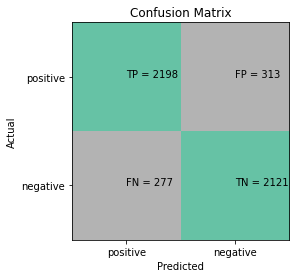

In [ ]:
model = 'Model 14'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'spaCy Lemmatised Text'
Training_Model = 'SVM'
stopwords = 'custom_stop_words'

vectorizer = TfidfVectorizer(ngram_range=(1,2), stop_words=custom_stop_words)
vectorizer.fit(X_train_scy_lemmatised_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_scy_lemmatised_text)
X_val = vectorizer.transform(X_val_scy_lemmatised_text)

m14 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Model 15
### Vectorization Technique: TfidfVector: lowercase=true
### ngram_range = (1,2)
### Train data: Cleaned text
### Training Model: SVM
### Stop words = custom stop words

Accuracy: 0.8783866367895702


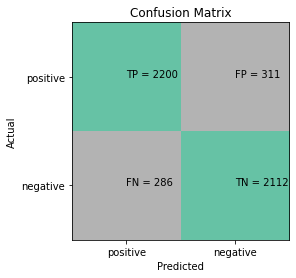

In [ ]:
model = 'Model 15'
Vectorization_Technique = 'TfidfVectorizer'
lowercase= 'True'
ngram_range = (1,2)
Train_data = 'Clean Text'
Training_Model = 'SVM'
stopwords = 'custom_stop_words'

vectorizer = TfidfVectorizer(ngram_range=(1,2), stop_words=custom_stop_words)
vectorizer.fit(X_train_clean_text)

# convert train and test text data to numeric vectors
X_train = vectorizer.transform(X_train_clean_text)
X_val = vectorizer.transform(X_val_clean_text)
m15 = get_svm_predictions(X_train, X_val, y_train, y_val, class_list)

### Summary
Based on our finding up to now, the above table can be updated to following version.

|Model | Vectorization_Technique | Features   |Accuracy|   Train Model
|------|--------------------|------------|--------|-----------------|
|M1    |-| CountVector(1-grams), lowercase | 0.860| SVM
|M2    |-| tf-idf vector(1-grams), lowercase | 0.869 | SVM
|M3    |-| tf-idf vector(1-grams), lowercase = False |0.863 | SVM
|M4    |tokenisation(NLTK) | tf-idf vector(1-grams), lowercase | 0.872|SVM
|M5   |lemmatisation(WordNet) | tf-idf vector(1-grams), lowercase | 0.870| SVM
|M6   |tokenisation(NLTK) | tf-idf vector(1,2-grams), lowercase | 0.875 |SVM
|M7    |tokenisation(NLTK), stop word removal | tf-idf vector(1,2-grams), lowercase| 0.8796 |SVM
|M8    |ltokenisation(NLTK), stop word removal | tf-idf vector(1,2-grams), lowercase | 0.8019 |DT Classifier
|M9    |tokenisation(NLTK), stop word removal | tf-idf vector(1,2-grams), lowercase | 0.8478 |RF Classifier
|M10    |tokenisation(NLTK), stop word removal | tf-idf vector(1,2-grams), lowercase | 0.7183 |NB Classifier
|M11    |tokenisation(NLTK), stop word removal | tf-idf vector(1,2-grams), lowercase | 0.8686 |SVM - rbf
|M12    |tokenisation(NLTK), stop word removal | tf-idf vector(1,2-grams), lowercase | 0.7234 |SVM - poly
|M13    |tokenisation(NLTK), stop word removal | tf-idf vector(1,3-grams), lowercase | 0.8755 |SVM Classifier
|M14    |spaCy Lemmatization, stop word removal | tf-idf vector(1,2-grams), lowercase | 0.8798 |SVM Classifier
|M15    |Clean_data, stop word removal | tf-idf vector(1,2-grams), lowercase | 0.8783 |SVM Classifier


In [ ]:
#import test data
test = pd.read_csv('test.csv')

# iterate through each row in 'Text' columm and convert text to tokens
test_spaCylemma_text = test["text"].apply(lemmatize)

# convert train and test text data to numeric vectors
X_test = vectorizer.transform(test_spaCylemma_text)

predictions = m14.predict(X_test)


In [ ]:
test['prediction'] = predictions
test.head()

,id,text,predictions,prediction
0,96d74cb729,Shanghai is also really exciting (precisely -...,positive,positive
1,eee518ae67,"Recession hit Veronique Branquinho, she has to...",negative,negative
2,01082688c6,happy bday!,positive,positive
3,33987a8ee5,http://twitpic.com/4w75p - I like it!!,positive,positive
4,726e501993,that`s great!! weee!! visitors!,positive,positive


In [ ]:
test.to_csv('/content/test_prediction.csv', index=False)

In [ ]:
import json
test_file_path = "/content/test_prediction.csv"
df_test = pd.read_csv(test_file_path)
df_test = df_test[["id", "prediction"]]

data = []
for index, row in df_test.iterrows():
    data.append({'id': row['id'], 'prediction': row['prediction']})

print(data[0:5])

submission_file_path = "submission.json"
with open(submission_file_path, 'w') as fp:
    fp.write('\n'.join(json.dumps(i) for i in data))

[{'id': '96d74cb729', 'prediction': 'positive'}, {'id': 'eee518ae67', 'prediction': 'negative'}, {'id': '01082688c6', 'prediction': 'positive'}, {'id': '33987a8ee5', 'prediction': 'positive'}, {'id': '726e501993', 'prediction': 'positive'}]
